In [1]:
import numpy as np
import cv2
import glob
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
%load_ext autoreload
%autoreload 2

In [44]:
def image_row_show(images, titles, figsize=(24, 9), fontsize=50, cmaps=None):
    num_images = len(images)
    
    f, axes = plt.subplots(1, num_images, figsize=figsize)
    f.tight_layout()
    
    if cmaps is None:
        cmaps = [None] * num_images
    
    for ax, img, title, cmap in zip(axes, images, titles, cmaps):
        ax.imshow(img, cmap=cmap)
        ax.set_title(title, fontsize=fontsize)
    plt.subplots_adjust(left=0., right=1., top=0.9, bottom=0.)

def rgb_image(path):
    return cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB)

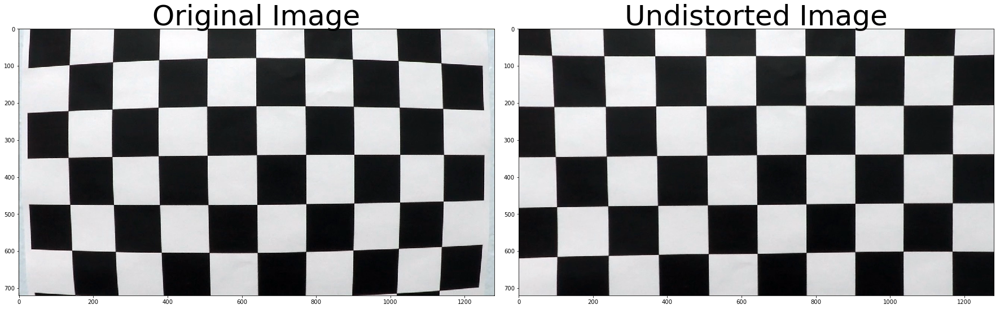

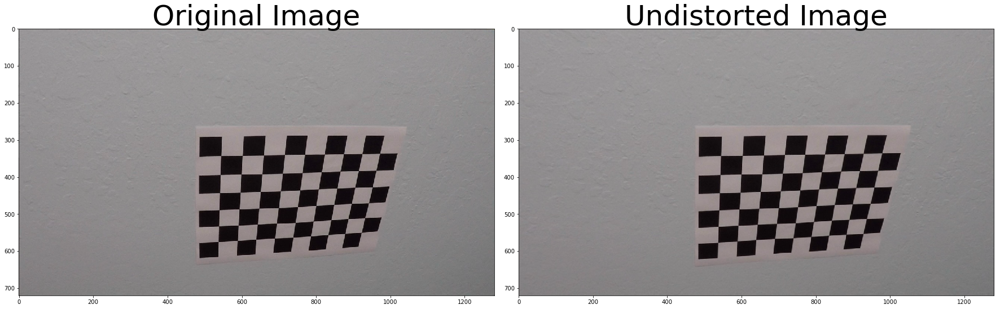

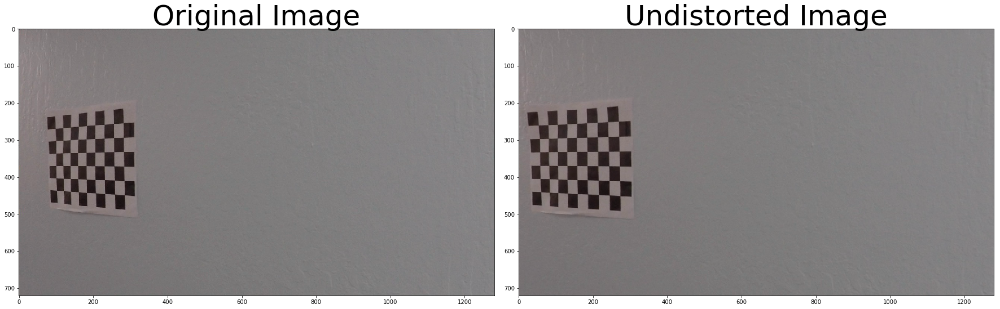

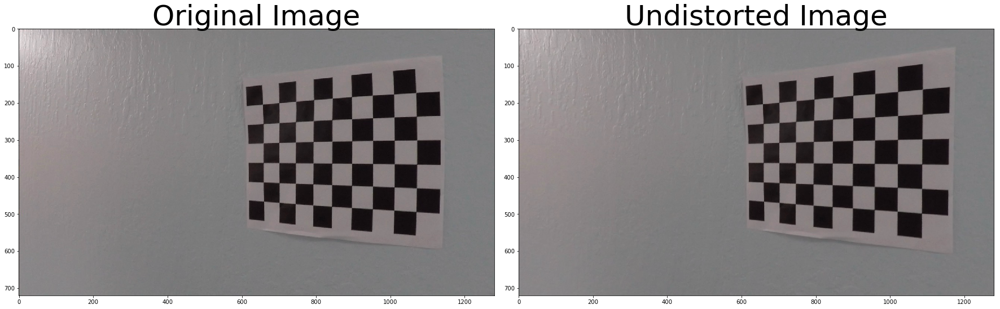

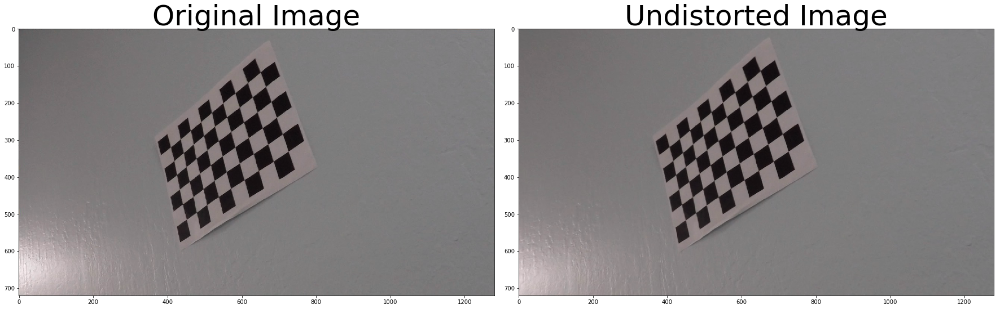

...

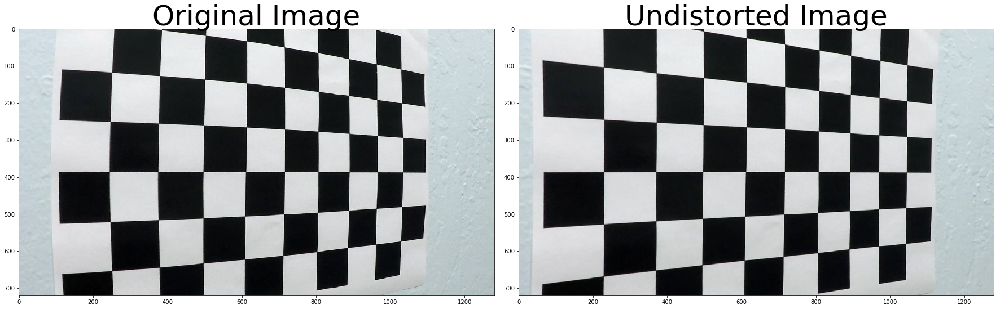

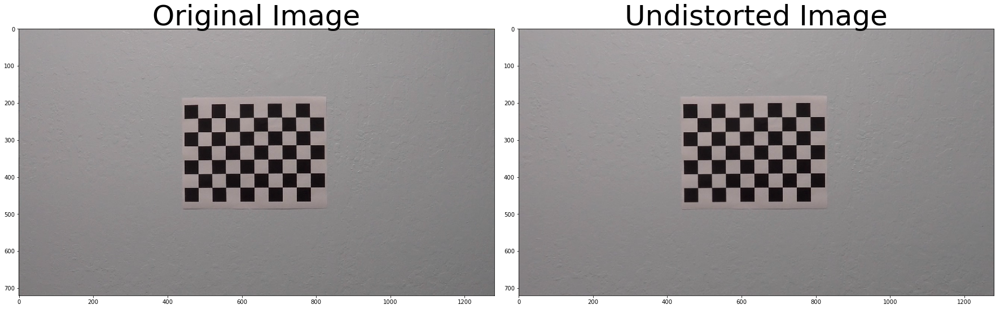

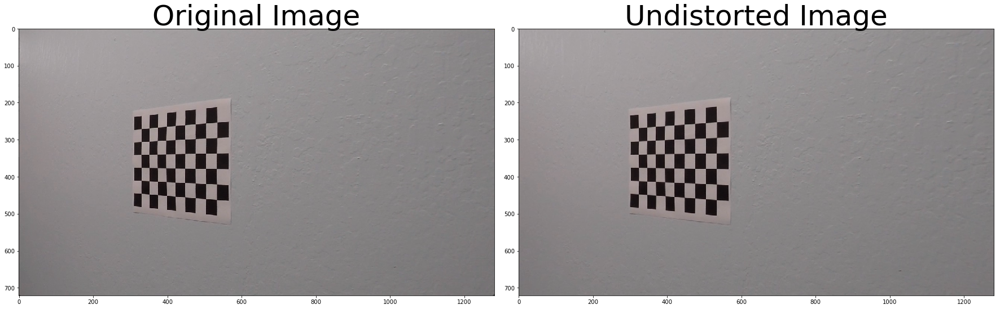

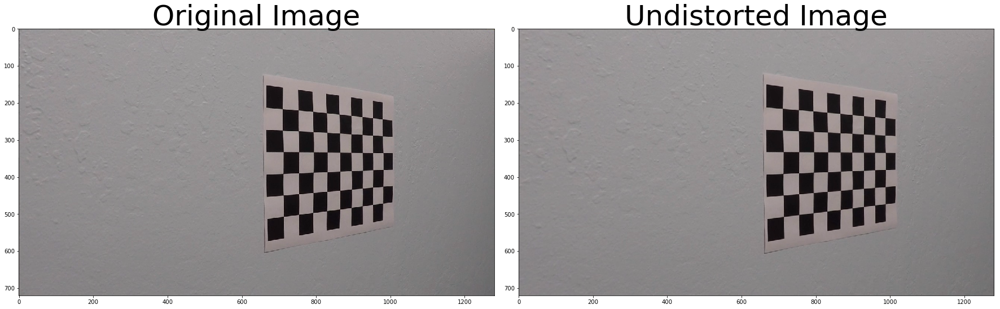

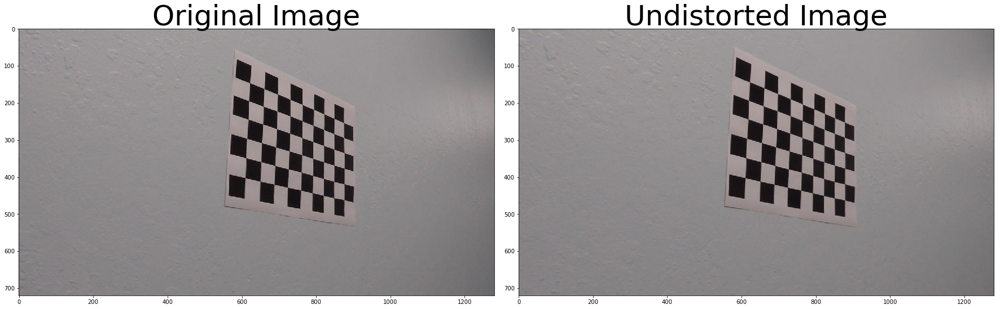

In [3]:
from detector import Camera

camera = Camera()

fnames = glob.glob('./camera_cal/calibration*.jpg')
param = camera.calibrate(fnames, (6, 9))

# apply distortion correction
for fname in fnames:
    img = cv2.imread(fname)
    undistorted = camera.undistort(img)
    image_row_show([img, undistorted], ["Original Image", "Undistorted Image"])

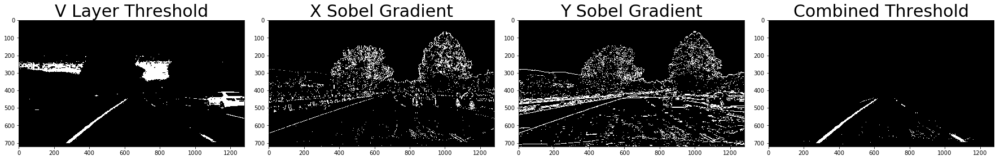

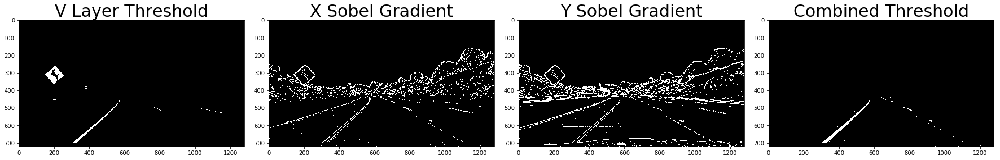

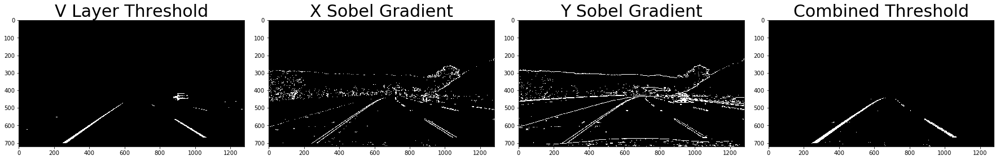

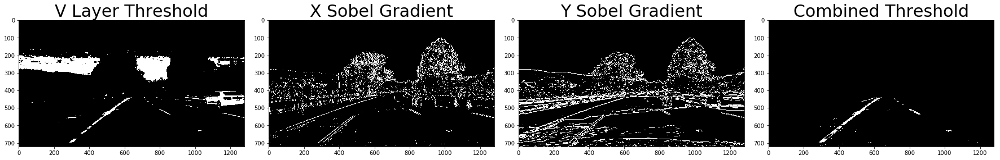

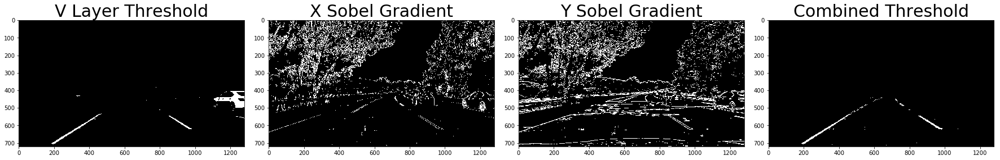

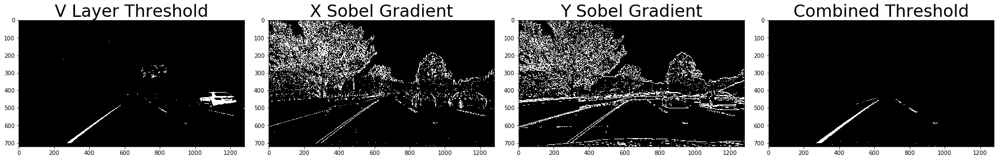

In [131]:
from detector import ImageWrapper
import math

test_fnames = glob.glob('./test_images/test*.jpg')

param = {
    "grad_x": {
        "min": 20,
        "max": 150
    },
    "grad_y": {
        "min": 20,
        "max": 150
    },
    "grad_mag": {
        "min": 20,
        "max": 225
    },
    "grad_dir": {
        "min": 0.8,
        "max": 1.2
    },
    "grad_color": {
        "min": 220,
        "max": 255
    },
}

for path in test_fnames:
    image = cv2.imread(path)
    image = camera.undistort(image)
    wrapper = ImageWrapper(image, param)

    image_row_show([wrapper.grad_color_bin, wrapper.grad_x_bin, wrapper.grad_y_bin, wrapper.combined], 
                   ["V Layer Threshold", "X Sobel Gradient", "Y Sobel Gradient", "Combined Threshold"],
                   fontsize=30, cmaps=['gray'] * 4)

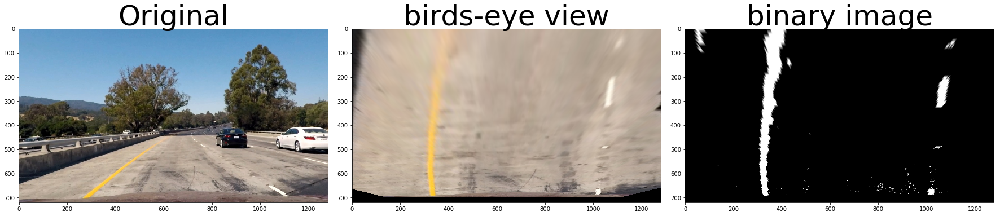

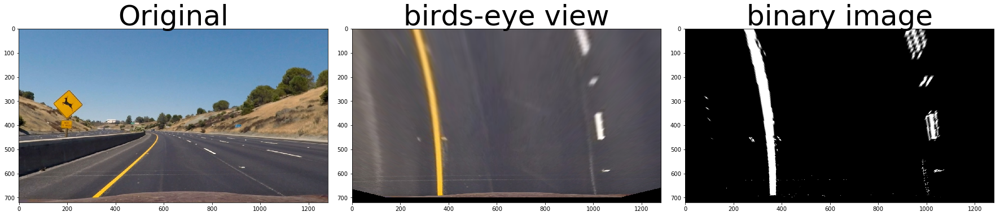

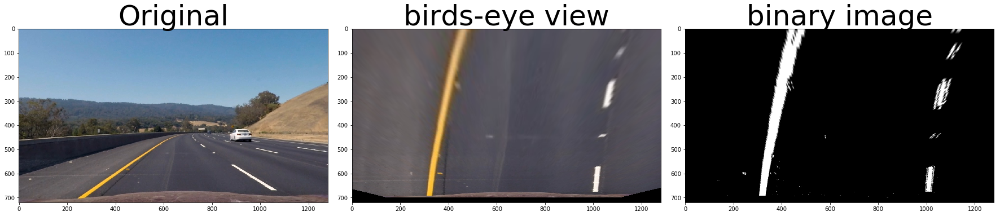

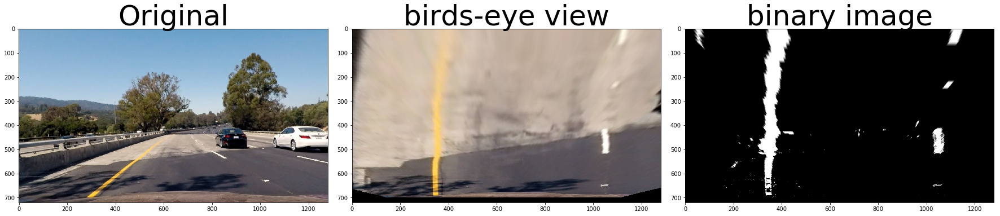

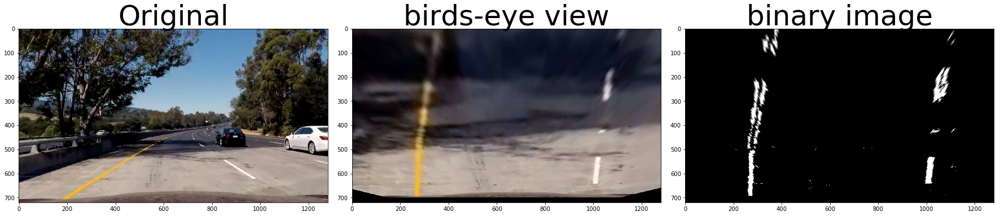

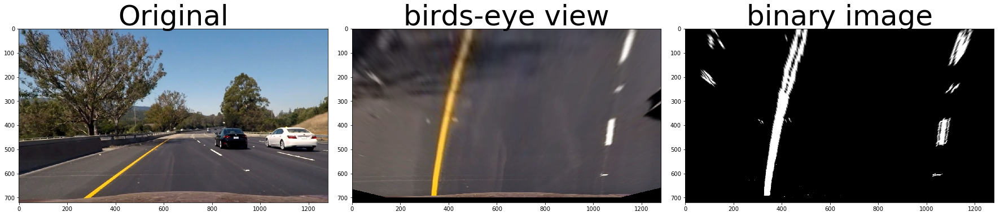

In [151]:
# src = np.array([(262, 682), (598, 448), (681, 448), (1049, 682)], dtype=np.float32)
src = np.array([(262, 682), (575, 464), (707, 464), (1049, 682)], dtype=np.float32)
dst = np.array([(300, 682), (300, 20), (980, 20), (980, 682)], dtype=np.float32)

camera.calculate_perspective_transform(src, dst)

for path in glob.glob("test_images/test*"):
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = camera.undistort(image)
    wrapper = ImageWrapper(image, param)
    warped = camera.warp_perspective(wrapper.combined)
    
    image_row_show([image, camera.warp_perspective(image), warped],
                   ["Original", "birds-eye view", "binary image"],
                   cmaps=["gray"]*3)

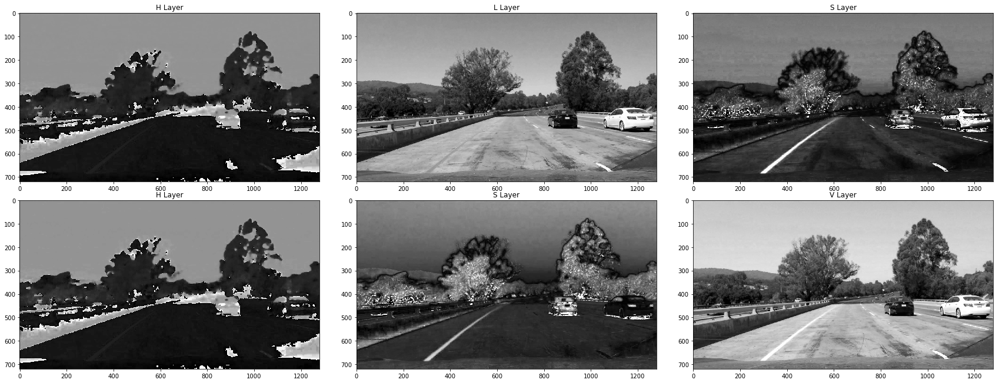

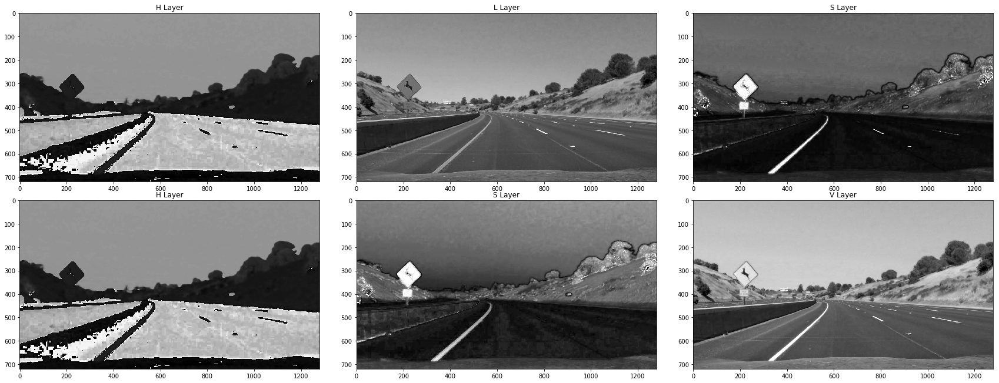

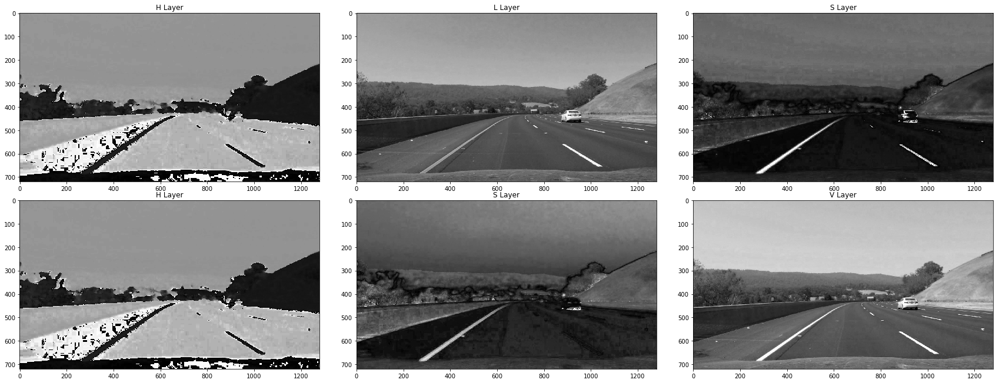

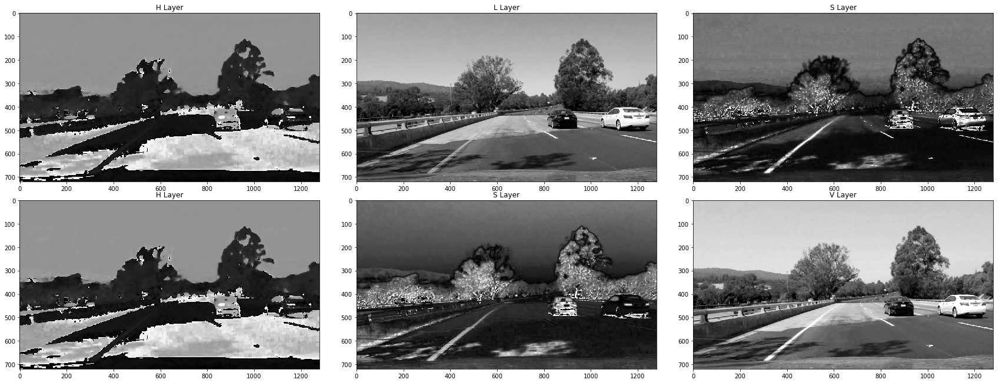

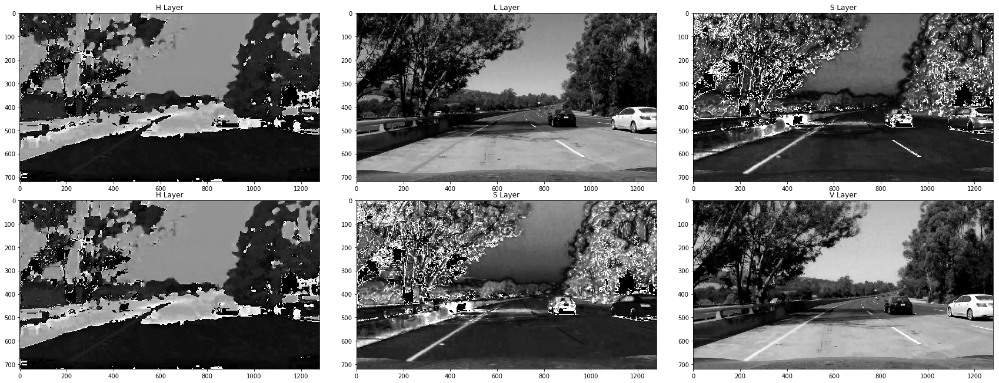

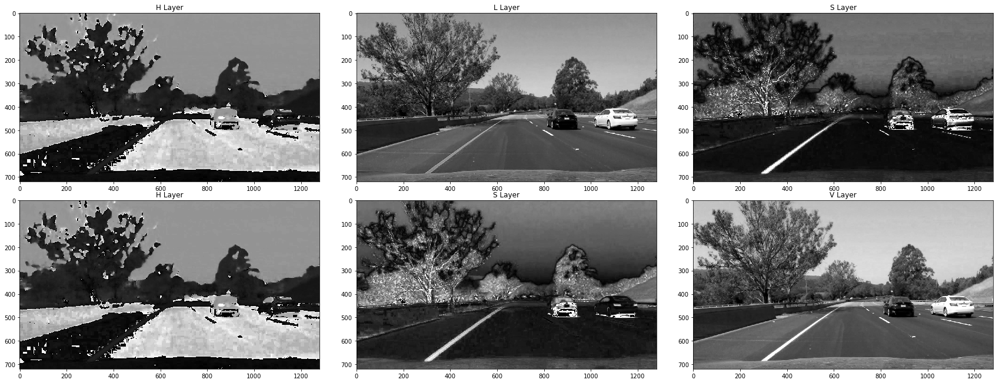

In [125]:
for path in test_fnames:
    image = cv2.imread(path)
    hls = cv2.cvtColor(image, cv2.COLOR_BGR2HLS)
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    
    f, axeses = plt.subplots(2, 3, figsize=(24, 9))
    f.tight_layout()
    axeses[0][0].imshow(hls[:, :, 0], cmap='gray')
    axeses[0][0].set_title("H Layer")
    axeses[0][1].imshow(hls[:, :, 1], cmap='gray')
    axeses[0][1].set_title("L Layer")
    axeses[0][2].imshow(hls[:, :, 2], cmap='gray')
    axeses[0][2].set_title("S Layer")
    axeses[1][0].imshow(hsv[:, :, 0], cmap='gray')
    axeses[1][0].set_title("H Layer")
    axeses[1][1].imshow(hsv[:, :, 1], cmap='gray')
    axeses[1][1].set_title("S Layer")
    axeses[1][2].imshow(hsv[:, :, 2], cmap='gray')
    axeses[1][2].set_title("V Layer")

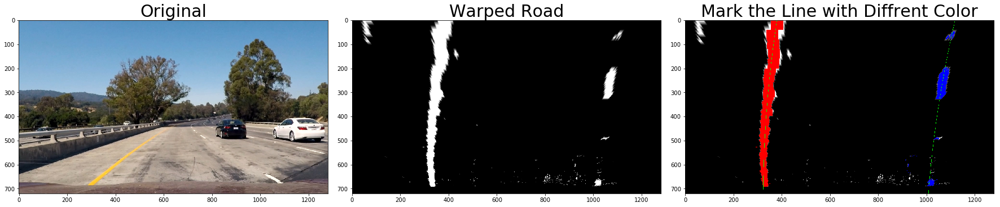

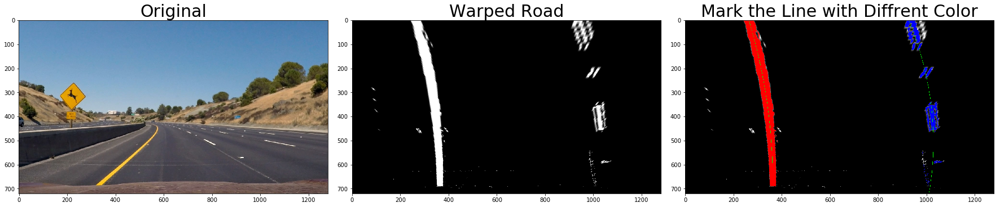

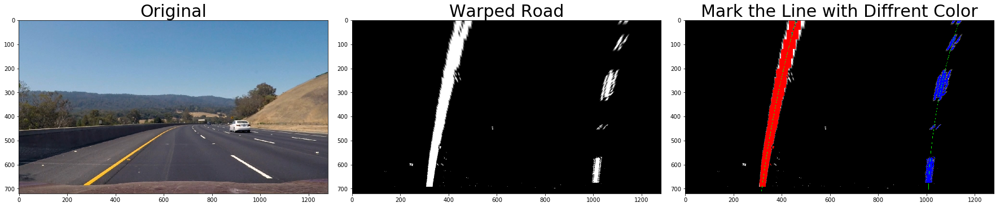

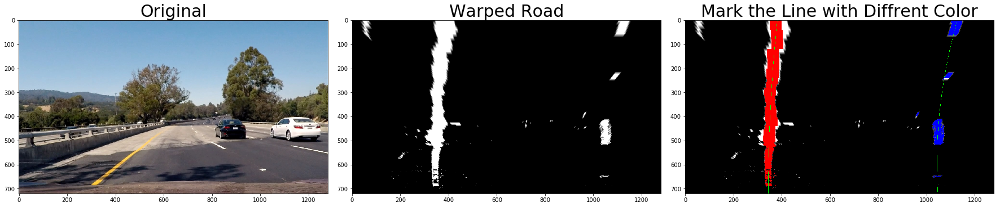

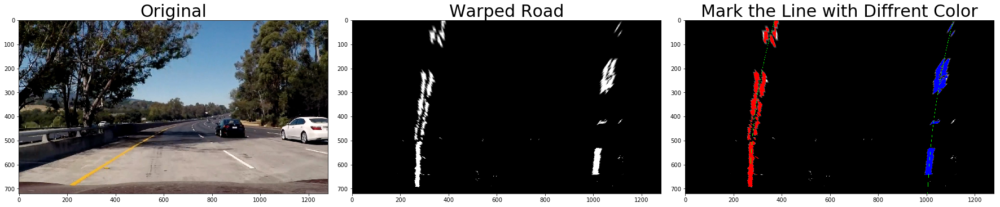

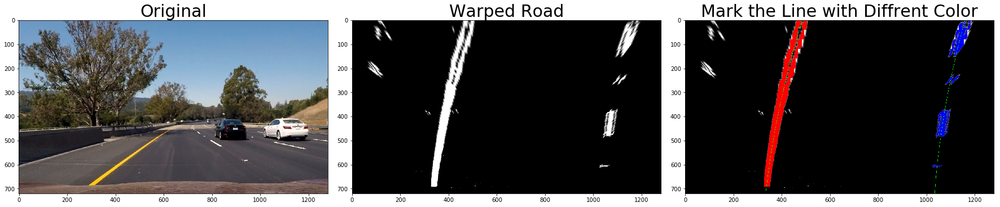

In [150]:
from detector import LaneDetector

for path in test_fnames:
    lane_detector = LaneDetector(camera, param)
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    lane_detector.detect(image)

    ploty = np.linspace(0, lane_detector.image_with_mask.shape[0]-1, lane_detector.image_with_mask.shape[0] )
    left_fitx = lane_detector.left_line.bestx
    right_fitx = lane_detector.right_line.bestx

    points = np.hstack([np.vstack([ploty, left_fitx]), np.vstack([ploty, right_fitx])]).T.astype(np.int32)
    mark = np.zeros([720, 2100], dtype=np.uint8)
    mark[[points[:, 0], points[:, 1]]] = 255
    if lane_detector.sanity_check():
        colored = lane_detector.colored_warp_image
        colored[[points[:, 0], points[:, 1]]] = [0, 255, 0]
        image_row_show([image, lane_detector.warped, lane_detector.colored_warp_image],
                   ["Original", "Warped Road", "Mark the Line with Diffrent Color"],
                   fontsize=30, cmaps=[None, "gray", None])

In [89]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

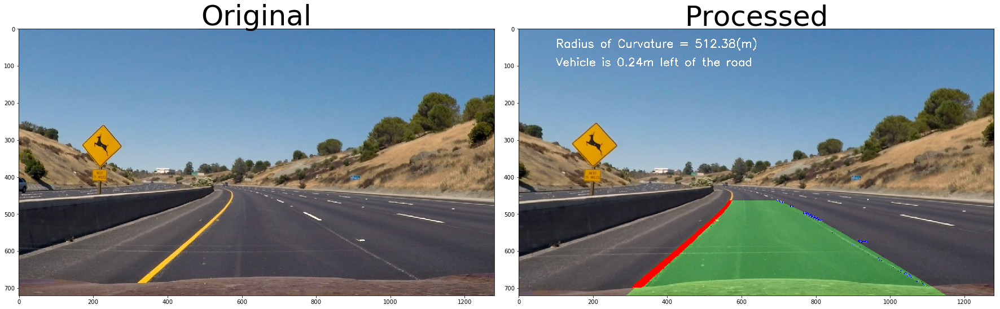

In [152]:
tmp_image = rgb_image("./test_images/test2.jpg")
tmp_detector = LaneDetector(camera, wrapper_params=param)
image_row_show([tmp_image, tmp_detector.detect(tmp_image)], ["Original", "Processed"])

In [155]:
project_output = "project.mp4"

project_detector = LaneDetector(camera, wrapper_params=param)
clip1 = VideoFileClip("project_video.mp4")
project_clip = clip1.fl_image(project_detector.detect) #NOTE: this function expects color images!!
%time project_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video project.mp4
[MoviePy] Writing video project.mp4


100%|█████████▉| 1260/1261 [03:57<00:00,  4.84it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project.mp4 

CPU times: user 5min 23s, sys: 37.4 s, total: 6min
Wall time: 3min 58s


In [154]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_output))